# **Nepali Sign Language Characters Classification**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## **Table of Contents**

1. [Import and Dependencies](#1-import-and-dependencies)
2. [Data Parsing and Configuration](#2-data-parsing-and-configuration)
3. [Dataset Statistics and Verification](#3-dataset-statistics-and-verification)
4. [Data Visualization](#4-data-visualization)
5. [Dataset Loading and Augmentation](#5-dataset-loading-and-augmentation)
    - [Data Augmentation](#51-data-augmentation)
    - [Data Augmentation Visualization](#52-data-augmentation-visualization)
6. [Dataset Preparation for Training](#6-dataset-preparation-for-training)
7. [MobileNetv2](#7-mobilenetv2)
    - [Model Training](#71-model-training)
    - [Model Evaluation](#72-model-evaluation)
    - [Model Inference](#73-model-inference)
        - [Single Inference](#731-single-inference)
        - [Batch Inference](#732-batch-inference)
8. [ResNet50](#8-resnet50)
    - [Model Training](#81-model-training)
    - [Model Evaluation](#82-model-evaluation)
    - [Model Inference](#83-model-inference)
        - [Single Inference](#831-single-inference)
        - [Batch Inference](#832-batch-inference)

*Note: Clickable links in a custom markdown table of contents do not work in Google Colab, please use the built-in Table of contents sidebar instead.*

## **1. Import and Dependencies**

In [ ]:
!pip install matplotlib tensorflow

In [3]:
import os
import random
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from tensorflow.keras.layers import RandomRotation
from tensorflow.keras import layers, applications, Model, Input
from tensorflow.keras.preprocessing.image import load_img, img_to_array

## **2. Data Parsing and Configuration**

In [11]:
def parse_tfrecord(example_proto):
    feature_description = {
        "image": tf.io.FixedLenFeature([], tf.string),
        "label": tf.io.FixedLenFeature([], tf.int64),
    }
    example = tf.io.parse_single_example(example_proto, feature_description)
    image = tf.image.decode_jpeg(example["image"], channels=3)
    image = tf.image.convert_image_dtype(image, tf.float32)
    label = example["label"]
    return image, label

In [12]:
train_tfrecord="/content/drive/MyDrive/tfrecords/train.tfrecord"
val_tfrecord="/content/drive/MyDrive/tfrecords/val.tfrecord"
test_tfrecord="/content/drive/MyDrive/tfrecords/test.tfrecord"

num_classes = 36
classes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35]

## **3. Dataset Statistics and Verification**

In [13]:
# counting the number of images
len_train = tf.data.TFRecordDataset(train_tfrecord)
len_test = tf.data.TFRecordDataset(val_tfrecord)

count_1 = sum(1 for _ in len_train)
count_2 = sum(1 for _ in len_test)

print("Number of images in the TFRecord:", count_1, count_2)

Number of images in the TFRecord: 37800 8100


## **4. Data Visualization**

In [14]:
# Sample 10 random images from each class
def sample_images(dataset, num_classes, num_samples=10):
    class_images = {i: [] for i in range(num_classes)}

    # Collect images for each class
    for image, label in dataset:
        label = int(label.numpy())
        if len(class_images[label]) < num_samples:
            class_images[label].append(image)
        if all(len(images) == num_samples for images in class_images.values()):
            break  # Stop if we have enough samples for all classes

    return class_images

def visualize_samples(class_images, num_samples=10):
    for label, images in class_images.items():
        print(f"Class {label}:")
        fig, axes = plt.subplots(1, num_samples, figsize=(20, 5))
        for i, img in enumerate(images):
            # Convert TensorFlow Tensor to NumPy array and normalize pixel values
            img_array = img.numpy()
            if img_array.dtype == float:  # Normalize if in range [0, 1]
                img_array = (img_array * 255).astype("uint8")
            axes[i].imshow(img_array)
            axes[i].axis("off")
        plt.show()

## **5. Dataset Loading and Augmentation**

In [15]:
def load_dataset(tfrecord_file, augment=False, include_tags=False): #including tags only for visualization purposes
    raw_dataset = tf.data.TFRecordDataset(tfrecord_file)
    parsed_dataset = raw_dataset.map(parse_tfrecord)

    if augment:
        if include_tags:
            parsed_dataset = parsed_dataset.map(apply_augmentations_with_tags, num_parallel_calls=tf.data.AUTOTUNE)
        else:
            parsed_dataset = parsed_dataset.map(apply_augmentations, num_parallel_calls=tf.data.AUTOTUNE)

    return parsed_dataset

Class 0:


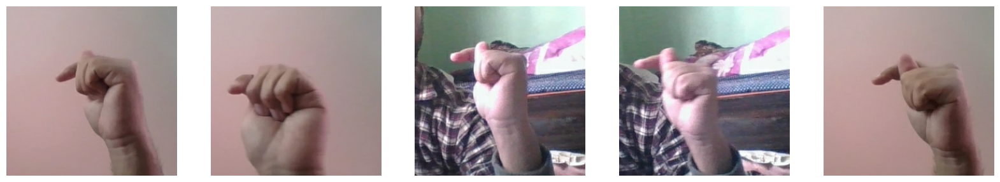

Class 1:


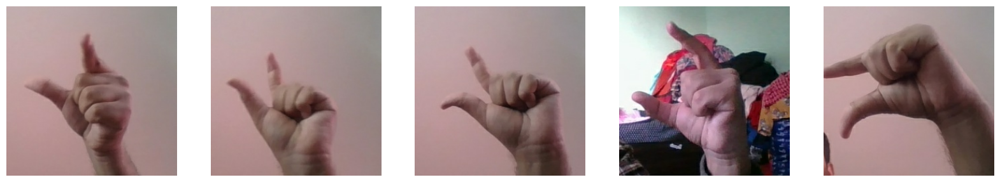

Class 2:


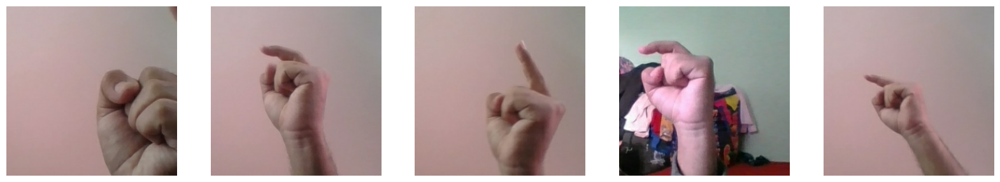

Class 3:


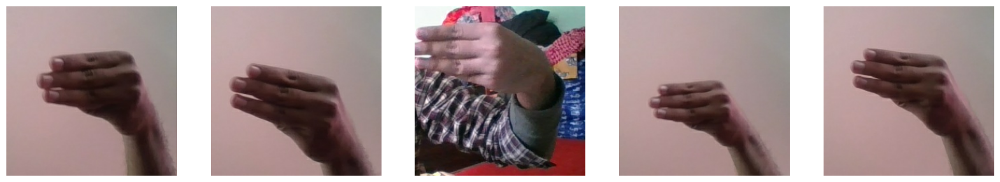

Class 4:


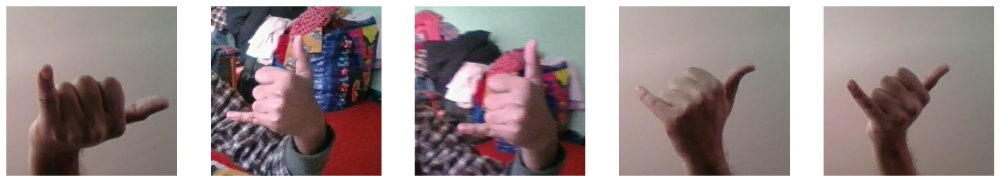

Class 5:


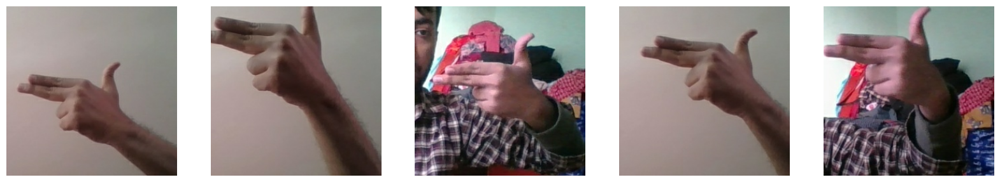

Class 6:


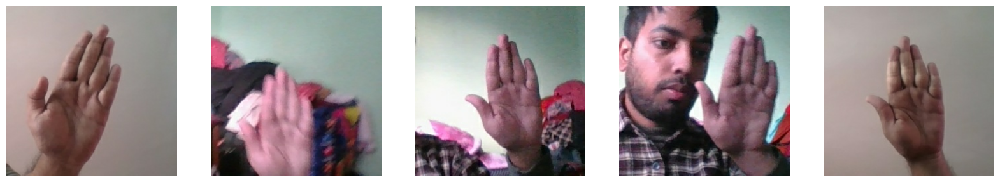

Class 7:


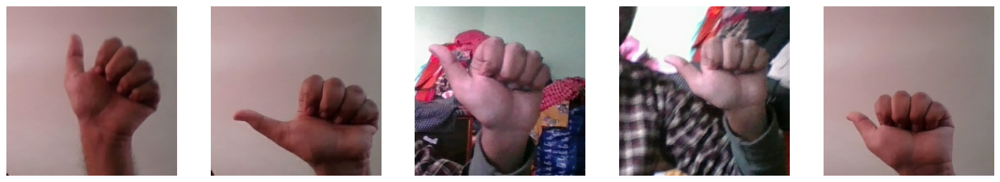

Class 8:


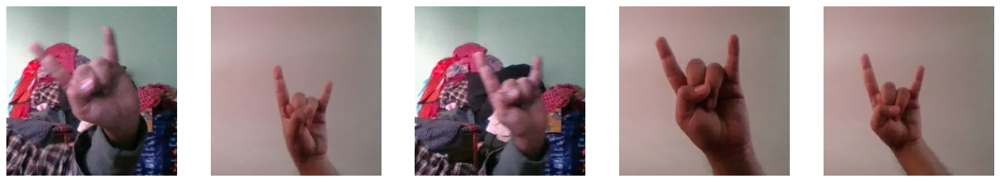

Class 9:


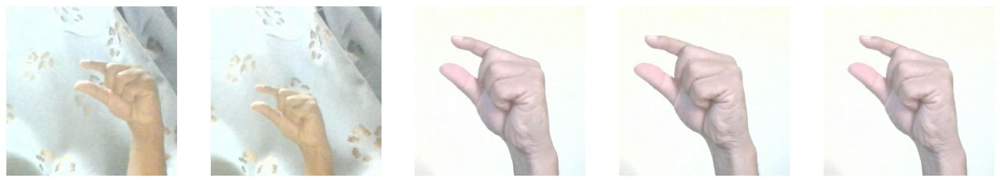

Class 10:


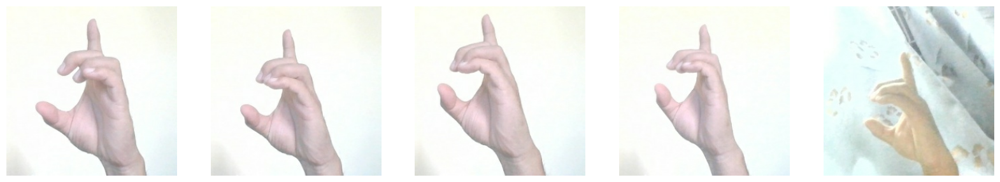

Class 11:


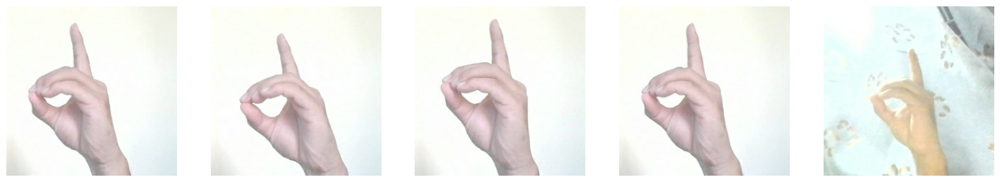

Class 12:


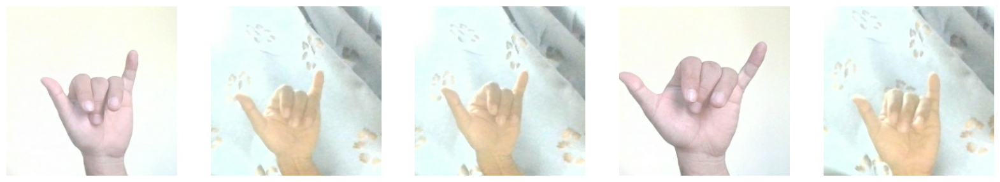

Class 13:


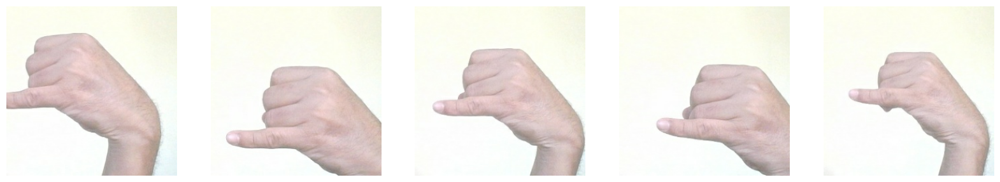

Class 14:


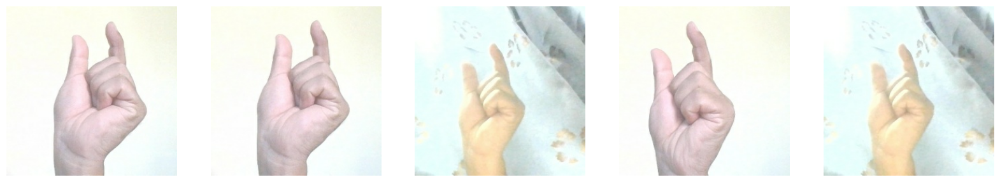

Class 15:


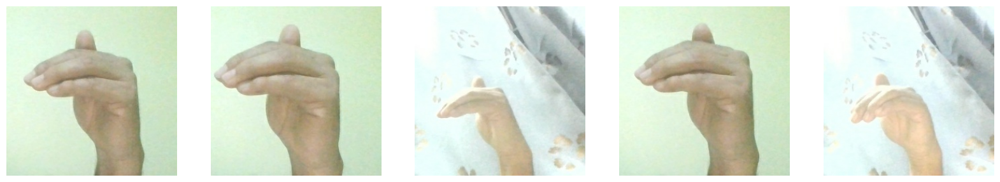

Class 16:


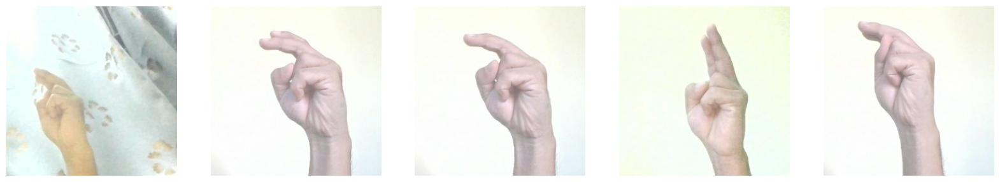

Class 17:


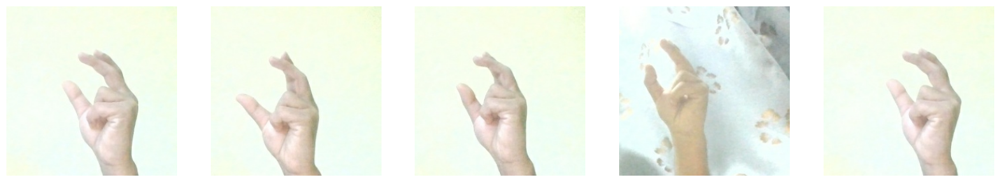

Class 18:


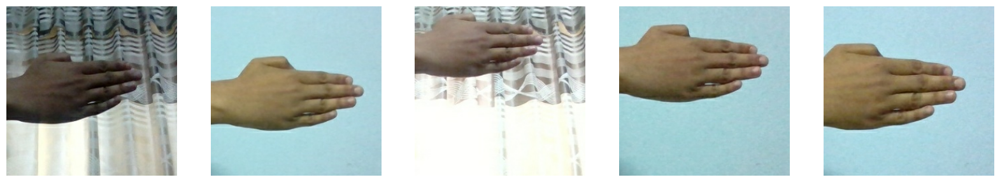

Class 19:


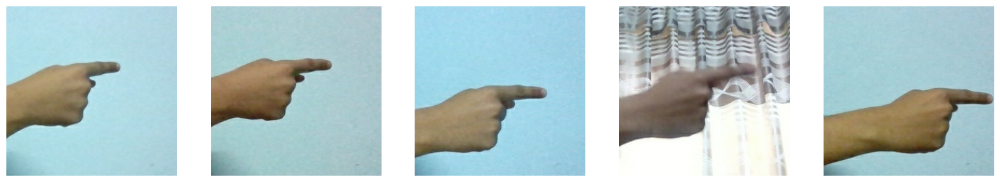

Class 20:


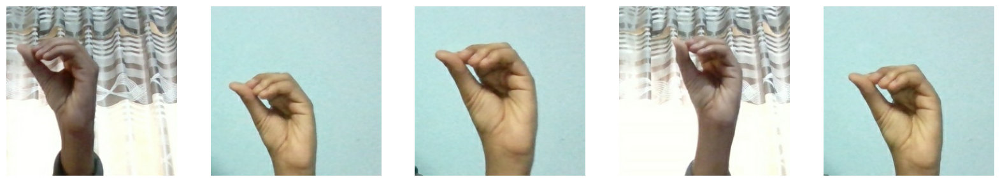

Class 21:


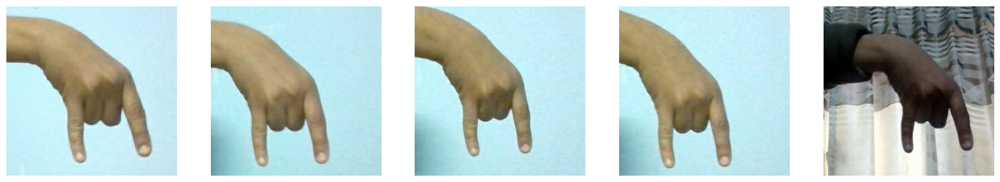

Class 22:


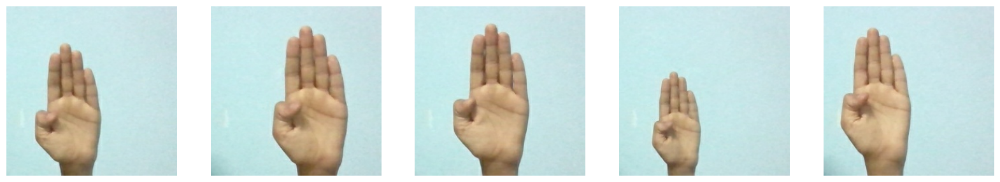

Class 23:


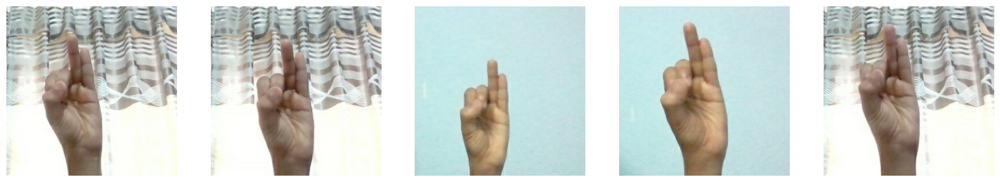

Class 24:


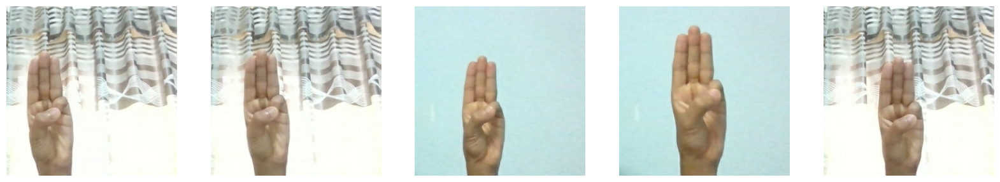

Class 25:


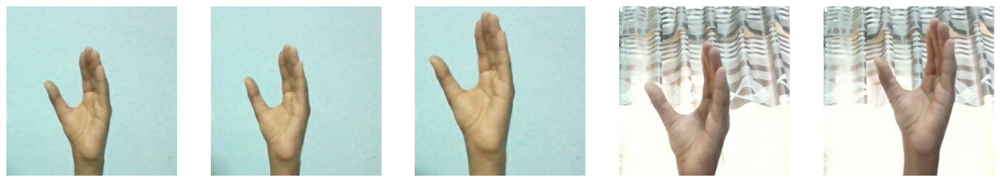

Class 26:


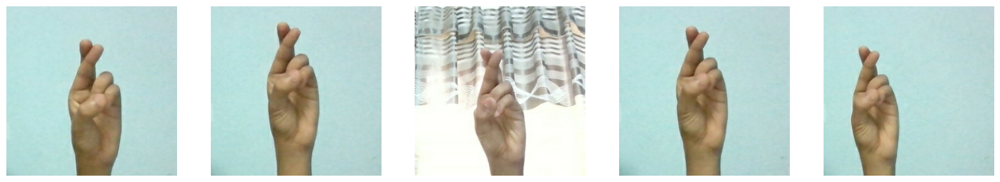

Class 27:


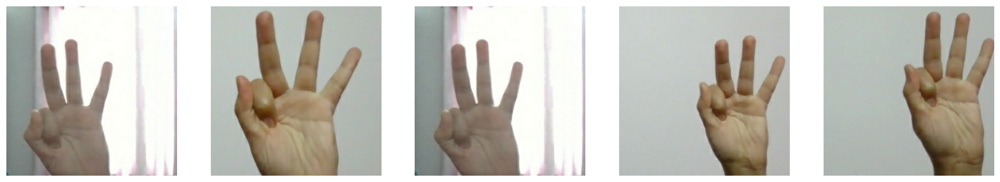

Class 28:


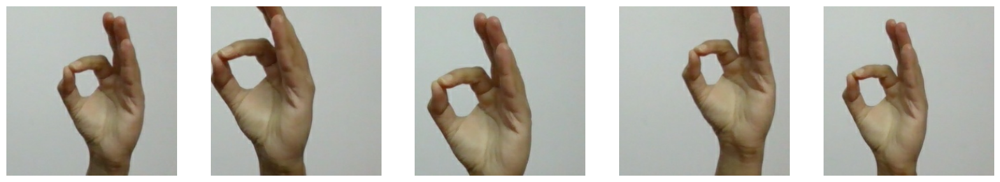

Class 29:


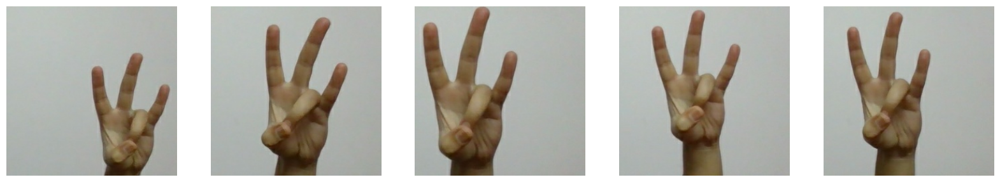

Class 30:


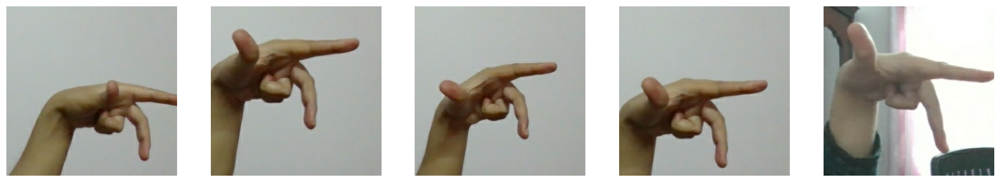

Class 31:


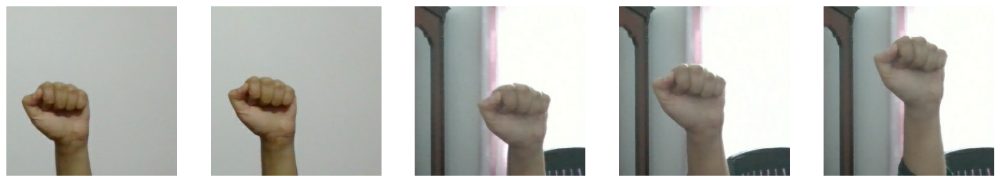

Class 32:


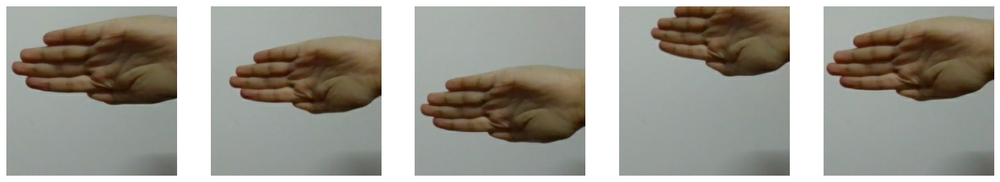

Class 33:


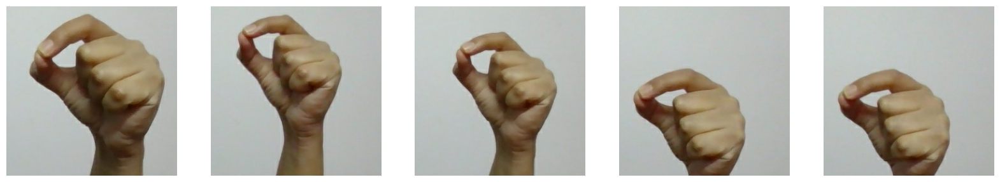

Class 34:


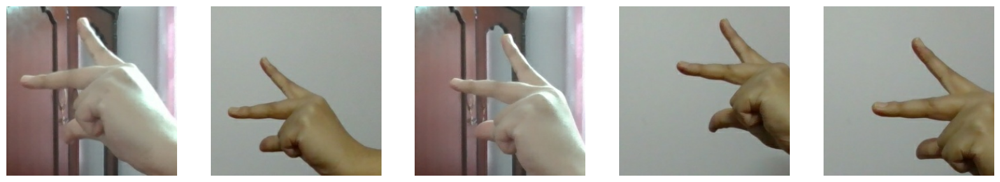

Class 35:


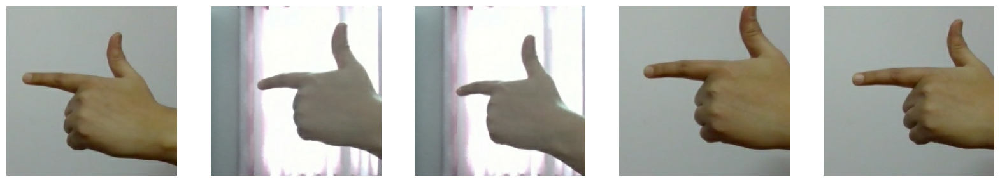

In [16]:
NUM_SAMPLES = 5

dataset = load_dataset(train_tfrecord)
class_images = sample_images(dataset, num_classes, NUM_SAMPLES)
visualize_samples(class_images, NUM_SAMPLES)

### **5.1 Data Augmentation**

In [17]:
tf.random.set_seed(42)
random_rotation = RandomRotation(factor=(-30 / 360, 30 / 360), fill_mode='reflect')

def apply_augmentations(image, label):
    image = tf.image.convert_image_dtype(image, dtype=tf.float32)
    # Random horizontal flip (30% probability)
    if tf.random.uniform([], seed=42) < 0.35:
        image = tf.image.flip_left_right(image)
    # Random contrast adjustment (5% probability)
    if tf.random.uniform([], seed=42) < 0.05:
        image = tf.image.random_contrast(image, lower=0.8, upper=1.2)
    # Random rotation (-30 to 30 degrees, 20% probability)
    if tf.random.uniform([], seed =42) < 0.25:
        image = random_rotation(image)
    return image, label

In [19]:
def apply_augmentations_with_tags(image, label):
    image = tf.image.convert_image_dtype(image, dtype=tf.float32)
    tag = "original"
    # Random horizontal flip (30% probability)
    if tf.random.uniform([], seed=42) < 0.35:
        image = tf.image.flip_left_right(image)
        tag="flipped"
    # Random contrast adjustment (5% probability)
    if tf.random.uniform([], seed=42) < 0.05:
        image = tf.image.random_contrast(image, lower=0.8, upper=1.2)
        tag="rotated"
    # Random rotation (-30 to 30 degrees, 20% probability)
    if tf.random.uniform([], seed =42) < 0.25:
        image = random_rotation(image)
    return image, label, tag


### **5.2 Data Augmentation Visualization**


In [20]:
def visualize_specific_augmentation(dataset, augmentation_tag, num_images):
    count = 0
    plt.figure(figsize=(12, 12))

    for image, label, tag in dataset.take(num_images * 2):  # Take extra to account for filtering
        if tag.numpy().decode("utf-8") == augmentation_tag:
            plt.subplot(5, 5, count + 1)
            plt.imshow(image.numpy())
            plt.title(f"Label: {label.numpy()}, Tag: {tag.numpy().decode('utf-8')}")
            plt.axis("off")
            count += 1
            if count >= num_images:
                break
    plt.tight_layout()
    plt.show()

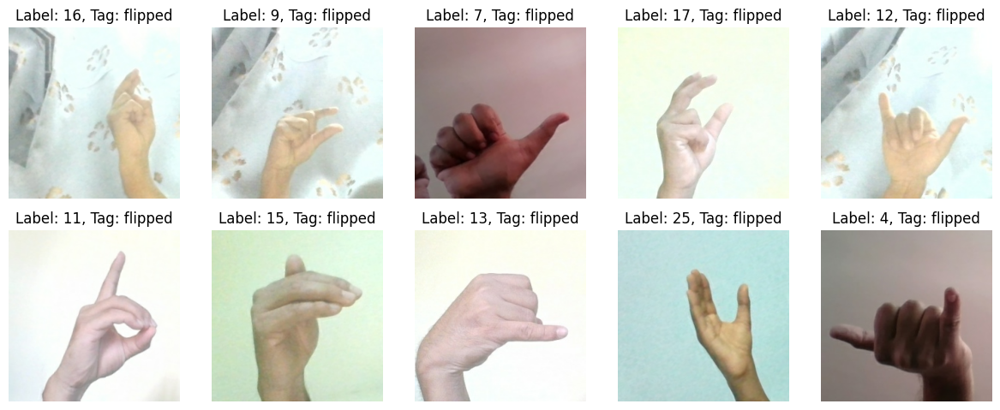

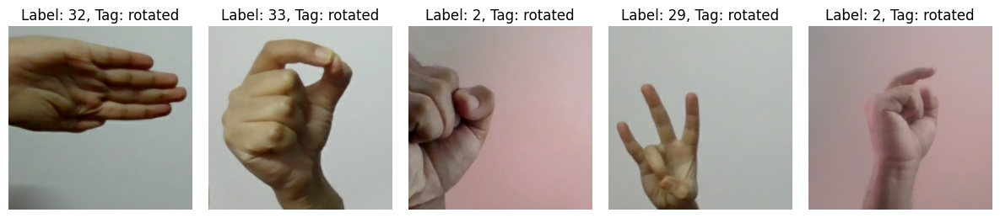

In [21]:
debug_dataset = load_dataset(train_tfrecord, augment=True, include_tags=True).batch(1)
visualize_specific_augmentation(debug_dataset.unbatch(), augmentation_tag="flipped", num_images=20)
visualize_specific_augmentation(debug_dataset.unbatch(), augmentation_tag="rotated", num_images=20)

## **6. Dataset Preparation for Training**

In [18]:
# With augmentations for training
train_dataset = load_dataset(train_tfrecord, augment=True)
train_dataset = train_dataset.batch(32).prefetch(tf.data.AUTOTUNE).repeat()

# Without augmentations for validation or test
val_dataset = load_dataset(val_tfrecord, augment=False)
val_dataset = val_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

test_dataset = load_dataset(test_tfrecord, augment=False)
test_dataset = test_dataset.batch(32).prefetch(tf.data.AUTOTUNE)

## **7. MobileNetv2**

### **7.1 Model Training**

In [23]:
base_model = tf.keras.applications.mobilenet_v2.MobileNetV2(input_shape=(256, 256, 3), include_top=False, weights='imagenet', alpha = 0.5)
base_model.trainable = False

/tmp/ipython-input-1047083484.py:1: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = tf.keras.applications.mobilenet_v2.MobileNetV2(input_shape=(256, 256, 3), include_top=False, weights='imagenet', alpha = 0.5)


3201480/3201480 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [24]:
model = tf.keras.Sequential([
base_model,
tf.keras.layers.GlobalAveragePooling2D(),
tf.keras.layers.Dense(128, activation='relu'), #128 should be enough
tf.keras.layers.Dropout(0.2),
tf.keras.layers.Dense(num_classes, activation='softmax')
])

In [25]:
model.summary(show_trainable=True)

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ mobilenetv2_0.50_224        │ (None, 8, 8, 1280)    │    706,224 │   N   │
│ (Functional)                │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d    │ (None, 1280)          │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 128)           │    163,968 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout (Dropout)           │ (None, 128)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_1 (Dense)             │ (None, 36)            │      4,644 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 874,836 (3.34 MB)

 Trainable params: 168,612 (658.64 KB)

 Non-trainable params: 706,224 (2.69 MB)

In [26]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.01)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

In [27]:
total_history = []

In [28]:
history = model.fit(train_dataset, steps_per_epoch=1184, epochs=3, validation_data=val_dataset)
total_history.append(history)

Epoch 1/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 156s 116ms/step - accuracy: 0.8078 - loss: 0.6601 - val_accuracy: 0.9702 - val_loss: 0.1001
Epoch 2/3
   5/1184 ━━━━━━━━━━━━━━━━━━━━ 31s 27ms/step - accuracy: 0.8889 - loss: 0.3591

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:160: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


1184/1184 ━━━━━━━━━━━━━━━━━━━━ 126s 106ms/step - accuracy: 0.9218 - loss: 0.2823 - val_accuracy: 0.9742 - val_loss: 0.0920
Epoch 3/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 107s 90ms/step - accuracy: 0.9370 - loss: 0.2570 - val_accuracy: 0.9751 - val_loss: 0.0976


In [29]:
print(len(base_model.layers))

154


In [30]:
for layer in base_model.layers[60:]:
  layer.trainable = True

In [31]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0005)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

In [32]:
history = model.fit(train_dataset, steps_per_epoch=1184, epochs=3, validation_data=val_dataset)
total_history.append(history)

Epoch 1/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 190s 128ms/step - accuracy: 0.7738 - loss: 1.0499 - val_accuracy: 0.8357 - val_loss: 1.4290
Epoch 2/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 134s 113ms/step - accuracy: 0.9516 - loss: 0.2101 - val_accuracy: 0.9033 - val_loss: 0.6077
Epoch 3/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 125s 105ms/step - accuracy: 0.9714 - loss: 0.1218 - val_accuracy: 0.9435 - val_loss: 0.2096


In [33]:
base_model.trainable=True

In [34]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

In [35]:
history = model.fit(train_dataset, steps_per_epoch=1184, epochs=4, validation_data=val_dataset)
total_history.append(history)

Epoch 1/4
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 262s 163ms/step - accuracy: 0.9818 - loss: 0.0727 - val_accuracy: 0.9973 - val_loss: 0.0129
Epoch 2/4
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 156s 131ms/step - accuracy: 0.9945 - loss: 0.0177 - val_accuracy: 0.9989 - val_loss: 0.0038
Epoch 3/4
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 154s 130ms/step - accuracy: 0.9957 - loss: 0.0149 - val_accuracy: 0.9985 - val_loss: 0.0063
Epoch 4/4
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 157s 133ms/step - accuracy: 0.9960 - loss: 0.0156 - val_accuracy: 0.9983 - val_loss: 0.0057


In [38]:
model_dir="/content/drive/MyDrive/tfrecords/mbnet2.keras"
model.save(model_dir)

### **7.2 Model Evaluation**

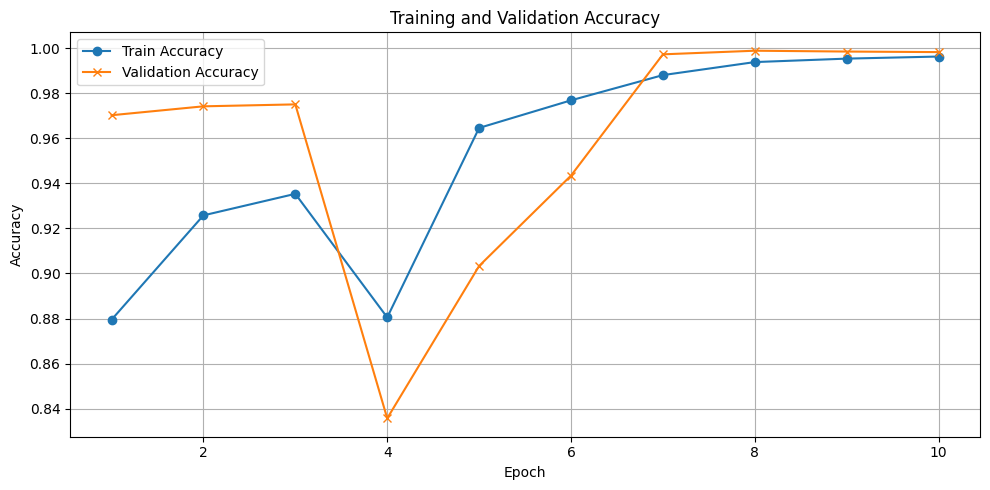

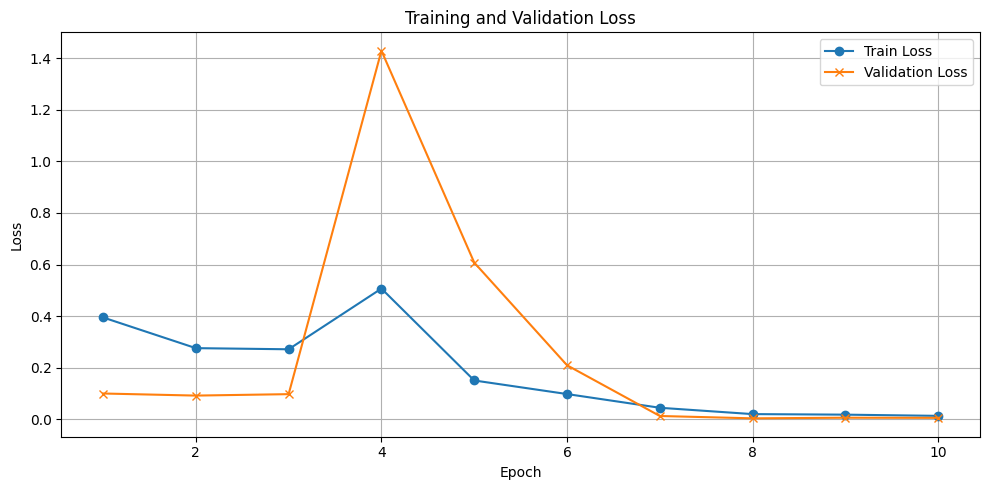

In [36]:
# Initialize lists
train_acc = []
val_acc = []
train_loss = []
val_loss = []
epochs = []

epoch_counter = 0

# Loop through each training history
for history in total_history:
    acc = history.history['accuracy']
    val = history.history['val_accuracy']
    loss = history.history['loss']
    val_l = history.history['val_loss']
    n = len(acc)

    train_acc.extend(acc)
    val_acc.extend(val)
    train_loss.extend(loss)
    val_loss.extend(val_l)
    epochs.extend(range(epoch_counter + 1, epoch_counter + n + 1))

    epoch_counter += n

# Plot Accuracy
plt.figure(figsize=(10, 5))
plt.plot(epochs, train_acc, label='Train Accuracy', marker='o')
plt.plot(epochs, val_acc, label='Validation Accuracy', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot Loss
plt.figure(figsize=(10, 5))
plt.plot(epochs, train_loss, label='Train Loss', marker='o')
plt.plot(epochs, val_loss, label='Validation Loss', marker='x')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


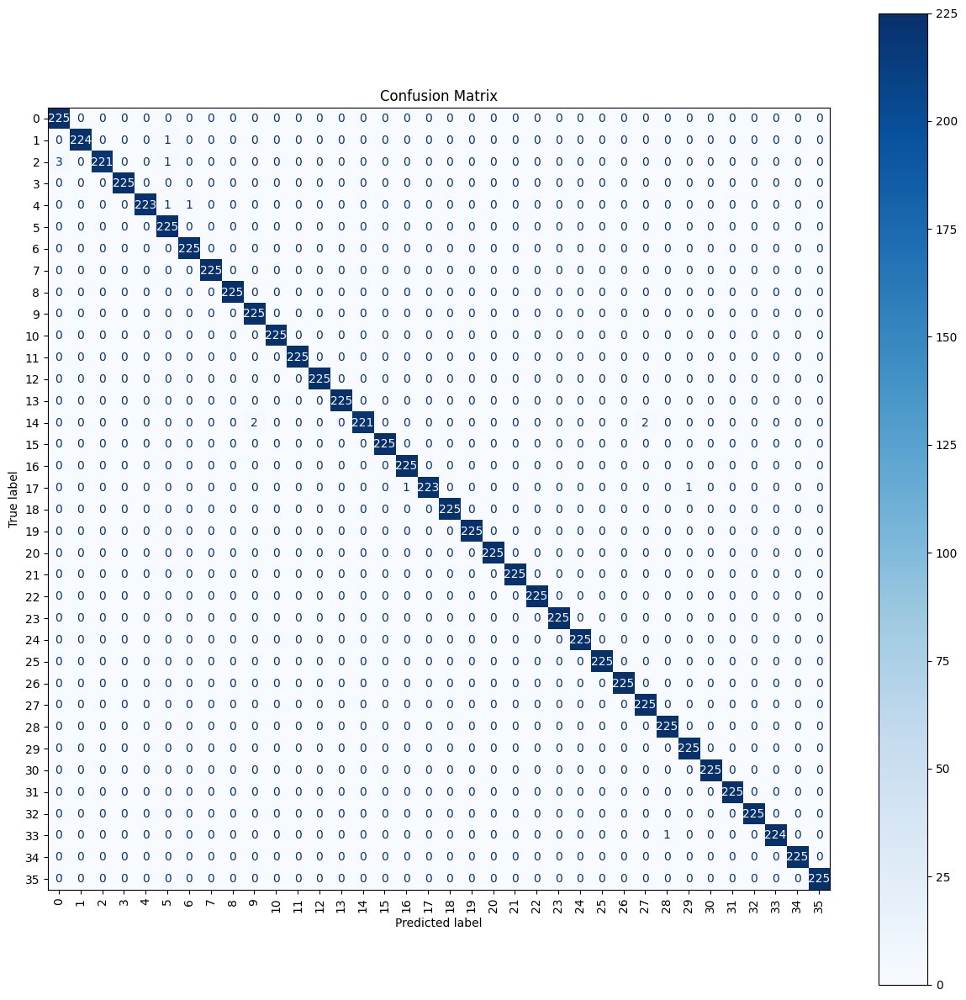

In [37]:
true_labels = []
predicted_labels = []

for images, labels in val_dataset:  # Iterate through the test dataset
    predictions = model.predict(images, verbose = 0)  # Get predictions
    predicted_classes = np.argmax(predictions, axis=1)  # Convert probabilities to class indices

    true_labels.extend(labels.numpy())  # Collect true labels
    predicted_labels.extend(predicted_classes)  # Collect predicted labels

# Compute the confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Set the figure size
plt.figure(figsize=(15, 15))  # Adjust the figsize as needed (width, height in inches)

# Plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classes)  # Adjust labels if needed
disp.plot(cmap=plt.cm.Blues, ax=plt.gca(), colorbar=True)  # Use plt.gca() to ensure it plots on the current figure

plt.title("Confusion Matrix")
plt.xticks(rotation=90)  # Rotate x-axis labels if they overlap
plt.show()

### **7.3 Model Inference**

In [40]:
model_dir="/content/drive/MyDrive/tfrecords/mbnet2.keras"
model = tf.keras.models.load_model(model_dir)

#### **7.3.1 Single Inference**

1/1 ━━━━━━━━━━━━━━━━━━━━ 12s 12s/step


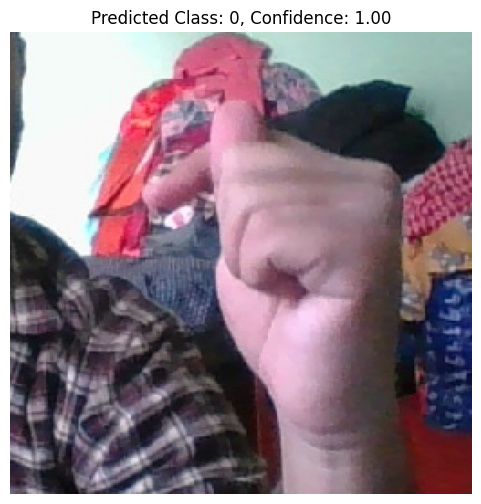

In [41]:
image_path = "/content/drive/MyDrive/tfrecords/0.jpg"
image_size = (256, 256)

image = load_img(image_path, target_size=image_size)
image_array = img_to_array(image)
image_array = image_array / 255.0
image_array = np.expand_dims(image_array, axis=0)  # Add batch dimension -> (1, H, W, C)

# Run inference
predictions = model.predict(image_array)
predicted_class = np.argmax(predictions, axis=1)
confidence = np.max(predictions)

# Visualize the result
plt.figure(figsize=(6, 6))
plt.imshow(image)
plt.title(f"Predicted Class: {predicted_class[0]}, Confidence: {confidence:.2f}")
plt.axis("off")
plt.show()

#### **7.3.2 Batch Inference**

In [ ]:
sample_images, sample_labels = [], []
num_samples=10

for images, labels in test_dataset.take(1):
    sample_images = images[:num_samples]
    sample_labels = labels[:num_samples]
    break

predictions = model.predict(sample_images, verbose=0)
predicted_classes = np.argmax(predictions, axis=1)
confidences = np.max(predictions, axis=1)

fig, axes = plt.subplots(2, 5, figsize=(15, 8))
axes = axes.flatten()

for i in range(num_samples):
    axes[i].imshow(sample_images[i])
    true_label = sample_labels[i].numpy()
    pred_label = predicted_classes[i]
    confidence = confidences[i]
    color = 'green' if true_label == pred_label else 'red'
    axes[i].set_title(f"True: {true_label}\nPred: {pred_label} ({confidence:.2f})", color=color)
    axes[i].axis('off')

plt.tight_layout()
plt.show()

## **8. ResNet50**

### **8.1 Model Training**

In [42]:
base_model = tf.keras.applications.ResNet50(
    input_shape=(256, 256, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(num_classes, activation='softmax')
])
model.summary(show_trainable=True)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ resnet50 (Functional)       │ (None, 8, 8, 2048)    │ 23,587,712 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d_1  │ (None, 2048)          │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_2 (Dense)             │ (None, 256)           │    524,544 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout_1 (Dropout)         │ (None, 256)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_3 (Dense)             │ (None, 36)            │      9,252 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 24,121,508 (92.02 MB)

 Trainable params: 533,796 (2.04 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [43]:
total_history = []

In [44]:
# Phase 1: Frozen base
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

history = model.fit(train_dataset, steps_per_epoch=1184, epochs=3, validation_data=val_dataset)
total_history.append(history)

Epoch 1/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 245s 182ms/step - accuracy: 0.0299 - loss: 3.6041 - val_accuracy: 0.0278 - val_loss: 3.5836
Epoch 2/3
   2/1184 ━━━━━━━━━━━━━━━━━━━━ 1:55 98ms/step - accuracy: 0.0078 - loss: 3.5848    

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:160: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


1184/1184 ━━━━━━━━━━━━━━━━━━━━ 255s 216ms/step - accuracy: 0.0251 - loss: 3.5840 - val_accuracy: 0.0278 - val_loss: 3.5836
Epoch 3/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 201s 170ms/step - accuracy: 0.0253 - loss: 3.5840 - val_accuracy: 0.0278 - val_loss: 3.5836


In [45]:
# Phase 2: Partial unfreezing
for layer in base_model.layers[140:]:
    layer.trainable = True
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

history = model.fit(train_dataset, steps_per_epoch=1184, epochs=3, validation_data=val_dataset)
total_history.append(history)

Epoch 1/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 294s 231ms/step - accuracy: 0.5026 - loss: 1.7788 - val_accuracy: 0.7941 - val_loss: 0.7166
Epoch 2/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 318s 269ms/step - accuracy: 0.8650 - loss: 0.4325 - val_accuracy: 0.6920 - val_loss: 1.0809
Epoch 3/3
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 259s 219ms/step - accuracy: 0.9155 - loss: 0.2804 - val_accuracy: 0.8395 - val_loss: 0.5483


In [46]:
# Phase 3: Full fine-tuning
base_model.trainable = True
optimizer = tf.keras.optimizers.Adam(learning_rate=0.00001)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])

history = model.fit(train_dataset, steps_per_epoch=1184, epochs=4, validation_data=val_dataset)
total_history.append(history)

Epoch 1/4
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 656s 438ms/step - accuracy: 0.7425 - loss: 0.9687 - val_accuracy: 0.9919 - val_loss: 0.0677
Epoch 2/4
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 488s 412ms/step - accuracy: 0.9925 - loss: 0.0311 - val_accuracy: 0.9990 - val_loss: 0.0042
Epoch 3/4
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 489s 413ms/step - accuracy: 0.9977 - loss: 0.0109 - val_accuracy: 0.9988 - val_loss: 0.0037
Epoch 4/4
1184/1184 ━━━━━━━━━━━━━━━━━━━━ 487s 411ms/step - accuracy: 0.9989 - loss: 0.0055 - val_accuracy: 0.9995 - val_loss: 0.0019


In [47]:
# Save model
model_dir = "/content/drive/MyDrive/tfrecords/resnet50.keras"
model.save(model_dir)
print(f"Model saved to {model_dir}")

Model saved to /content/drive/MyDrive/tfrecords/resnet50.keras


### **8.2 Model Evaluation**

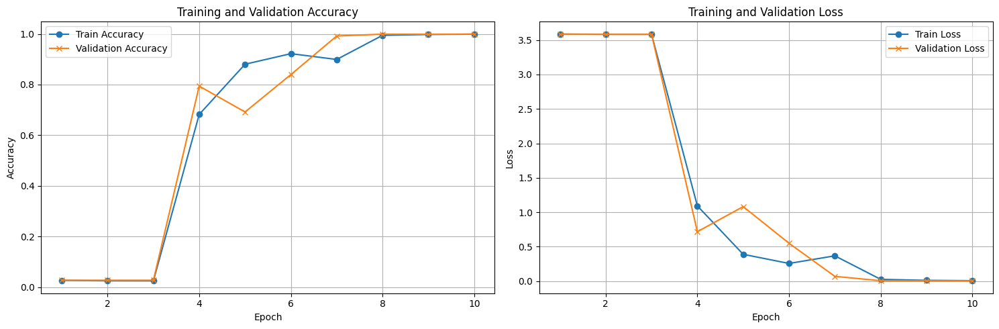

In [51]:
# Plot training curves
train_acc, val_acc, train_loss, val_loss, epochs = [], [], [], [], []
epoch_counter = 0

for history in total_history:
    acc = history.history['accuracy']
    val = history.history['val_accuracy']
    loss = history.history['loss']
    val_l = history.history['val_loss']
    n = len(acc)

    train_acc.extend(acc)
    val_acc.extend(val)
    train_loss.extend(loss)
    val_loss.extend(val_l)
    epochs.extend(range(epoch_counter + 1, epoch_counter + n + 1))
    epoch_counter += n

# Plot metrics
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

ax1.plot(epochs, train_acc, label='Train Accuracy', marker='o')
ax1.plot(epochs, val_acc, label='Validation Accuracy', marker='x')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Accuracy')
ax1.set_title('Training and Validation Accuracy')
ax1.legend()
ax1.grid(True)

ax2.plot(epochs, train_loss, label='Train Loss', marker='o')
ax2.plot(epochs, val_loss, label='Validation Loss', marker='x')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Loss')
ax2.set_title('Training and Validation Loss')
ax2.legend()
ax2.grid(True)

plt.tight_layout()
plt.show()

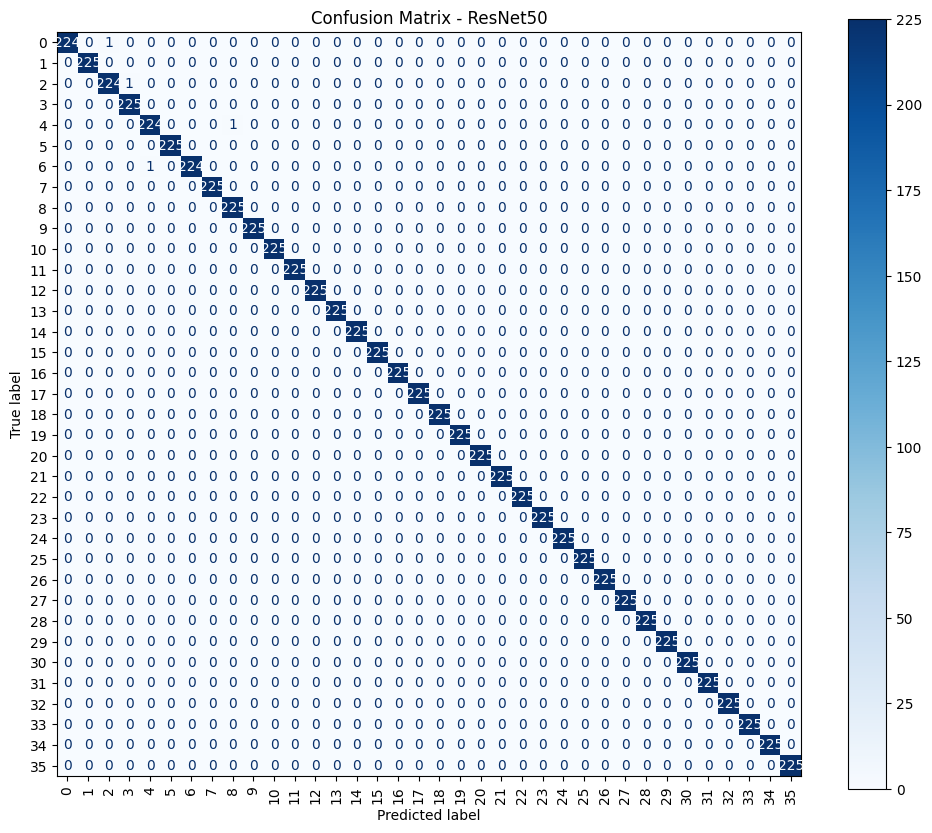

In [52]:
# Generate confusion matrix
true_labels, predicted_labels = [], []
for images, labels in val_dataset:
    predictions = model.predict(images, verbose=0)
    predicted_classes = np.argmax(predictions, axis=1)
    true_labels.extend(labels.numpy())
    predicted_labels.extend(predicted_classes)

cm = confusion_matrix(true_labels, predicted_labels)
plt.figure(figsize=(12, 10))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classes)
disp.plot(cmap=plt.cm.Blues, ax=plt.gca(), colorbar=True)
plt.title("Confusion Matrix - ResNet50")
plt.xticks(rotation=90)
plt.show()

### **8.3 Model Inference**

In [49]:
model_dir = "/content/drive/MyDrive/tfrecords/resnet50.keras"
model = tf.keras.models.load_model(model_dir)

#### **8.3.1 Single Inference**

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


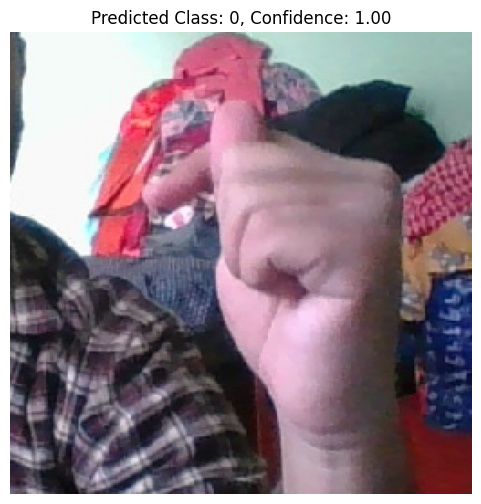

In [50]:
image_path = "/content/drive/MyDrive/tfrecords/0.jpg"
image_size = (256, 256)

image = load_img(image_path, target_size=image_size)
image_array = img_to_array(image)
image_array = image_array / 255.0
image_array = np.expand_dims(image_array, axis=0)  # Add batch dimension -> (1, H, W, C)

# Run inference
predictions = model.predict(image_array)
predicted_class = np.argmax(predictions, axis=1)
confidence = np.max(predictions)

# Visualize the result
plt.figure(figsize=(6, 6))
plt.imshow(image)
plt.title(f"Predicted Class: {predicted_class[0]}, Confidence: {confidence:.2f}")
plt.axis("off")
plt.show()

#### **8.3.2 Batch Inference**

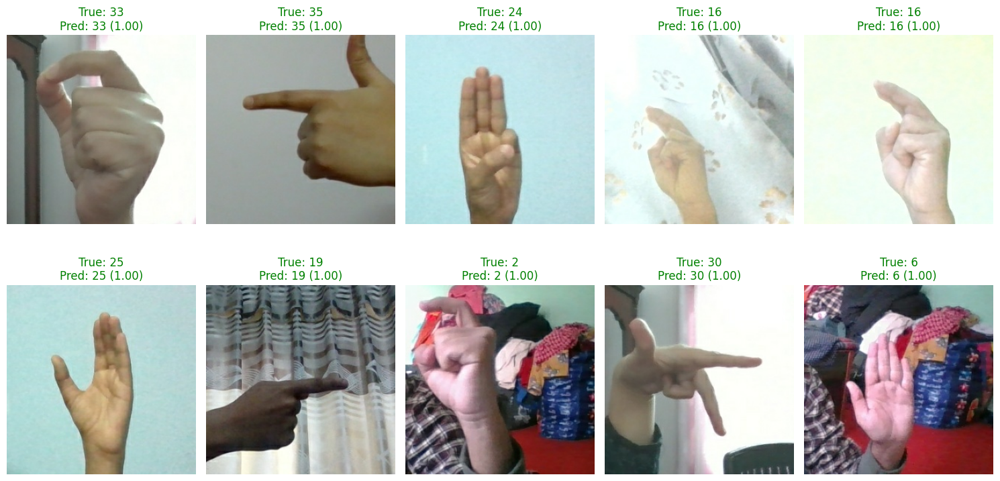

In [53]:
sample_images, sample_labels = [], []
num_samples=10

for images, labels in test_dataset.take(1):
    sample_images = images[:num_samples]
    sample_labels = labels[:num_samples]
    break

predictions = model.predict(sample_images, verbose=0)
predicted_classes = np.argmax(predictions, axis=1)
confidences = np.max(predictions, axis=1)

fig, axes = plt.subplots(2, 5, figsize=(15, 8))
axes = axes.flatten()

for i in range(num_samples):
    axes[i].imshow(sample_images[i])
    true_label = sample_labels[i].numpy()
    pred_label = predicted_classes[i]
    confidence = confidences[i]
    color = 'green' if true_label == pred_label else 'red'
    axes[i].set_title(f"True: {true_label}\nPred: {pred_label} ({confidence:.2f})", color=color)
    axes[i].axis('off')

plt.tight_layout()
plt.show()